#3. Filters

In [36]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import math
import pandas as pd
import random


In [15]:
elaine = cv2.imread('/content/sample_data/Elaine.bmp', cv2.IMREAD_GRAYSCALE)
m, n = elaine.shape
plt.set_cmap('gray')

<Figure size 432x288 with 0 Axes>

In [5]:
def addpadding(source,pad):
    imarr = np.array(source)
    padimarr = np.zeros((imarr.shape[0]+2*pad,
                         imarr.shape[1]+2*pad),dtype=np.uint8)
    padimarr[pad:padimarr.shape[0]-pad,
             pad:padimarr.shape[1]-pad]=imarr
    return padimarr

In [22]:
def convolve(filter,image):
  m = image.shape[0]
  n = image.shape[1]

  filter_size = filter.shape[0]
  a = b = filter_size//2
  image_padded = addpadding(image, filter_size//2)

  image_conv = np.zeros(image_padded.shape)

  for x in range(a, image_padded.shape[0]-a):
    for y in range(b, image_padded.shape[1]-b):
      arr = image_padded[x-a : x-a+filter_size,
                       y-b : y-b+filter_size]
      arr = arr.flatten()*filter.flatten()
      image_conv[x][y] = arr.sum()

  h_end = -a
  w_end = -b
    
  if(a == 0):
    return image_conv[a:,b:w_end]
  if(b == 0):
    return image_conv[a:h_end,b:]
  return image_conv[a:h_end,b:w_end]

##3.1 Box Filter

In [7]:
def box_filter(n):
    if(n <= 2):
        n = 3
    elif(n%2 == 0):
        n = n+1 
    box_filter=np.ones((n,n))*(1/n**2)
    return box_filter

###3.1.3 res

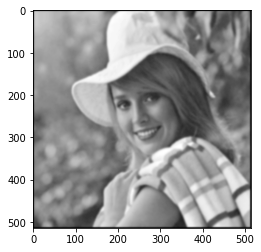

In [21]:
box_f3 = box_filter(3)
blur1 = convolve(box_f3,elaine)
blur2 = convolve(box_f3,blur1)
blur3 = convolve(box_f3,blur2)
blur4 = convolve(box_f3,blur3)
blur5 = convolve(box_f3,blur4)
blur6 = convolve(box_f3,blur5)

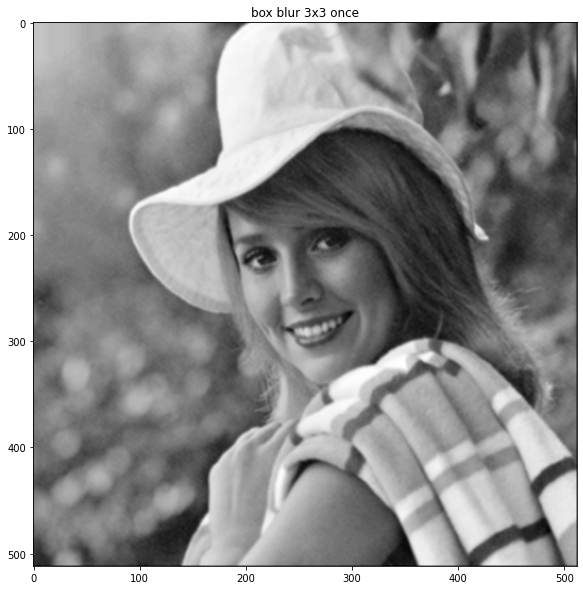

In [23]:
plt.figure(figsize=(10,10))
plt.title('box blur 3x3 once')
plt.imshow(blur1)

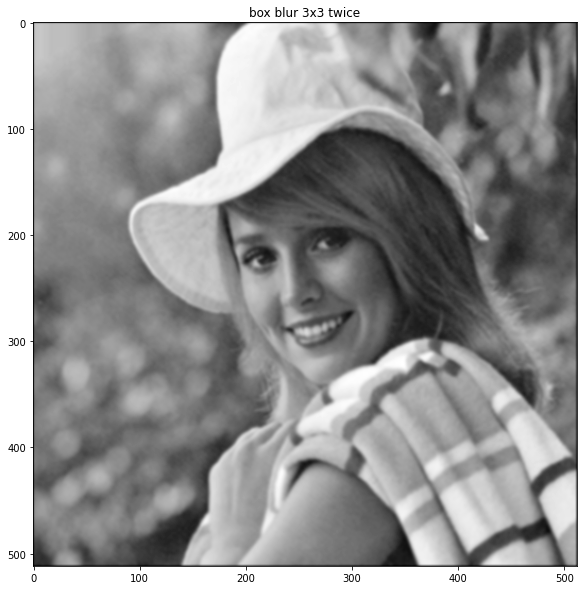

In [24]:
plt.figure(figsize=(10,10))
plt.title('box blur 3x3 twice')
plt.imshow(blur2)

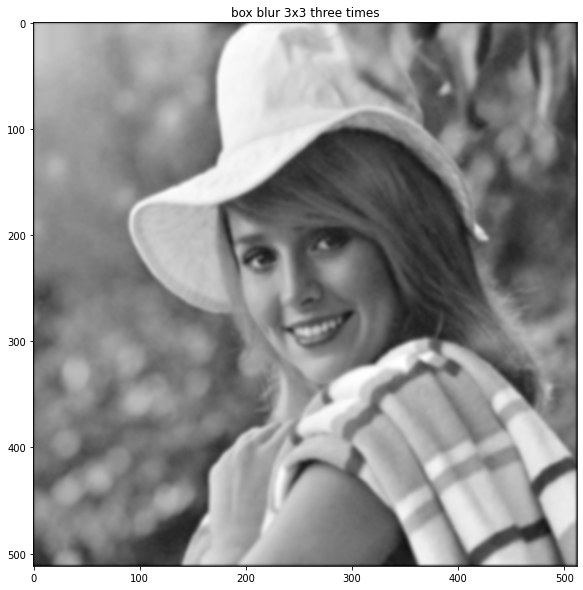

In [25]:
plt.figure(figsize=(10,10))
plt.title('box blur 3x3 three times')
plt.imshow(blur3)

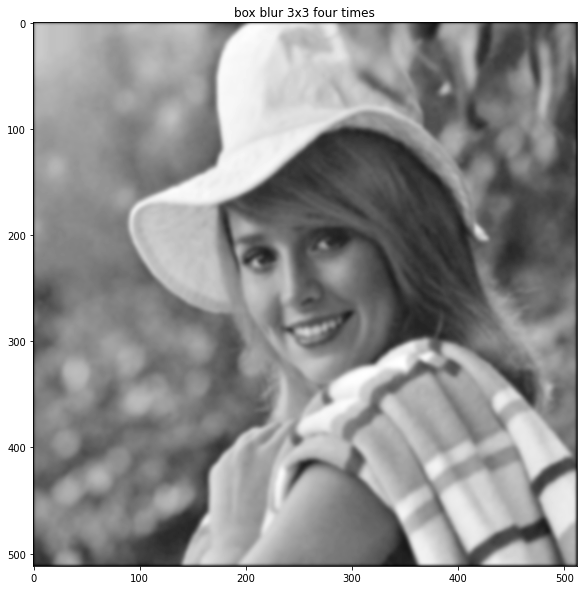

In [26]:
plt.figure(figsize=(10,10))
plt.title('box blur 3x3 four times')
plt.imshow(blur4)

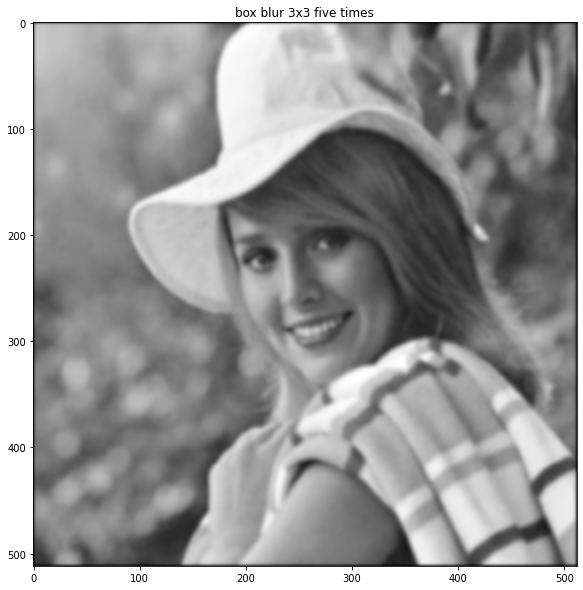

In [27]:
plt.figure(figsize=(10,10))
plt.title('box blur 3x3 five times')
plt.imshow(blur5)

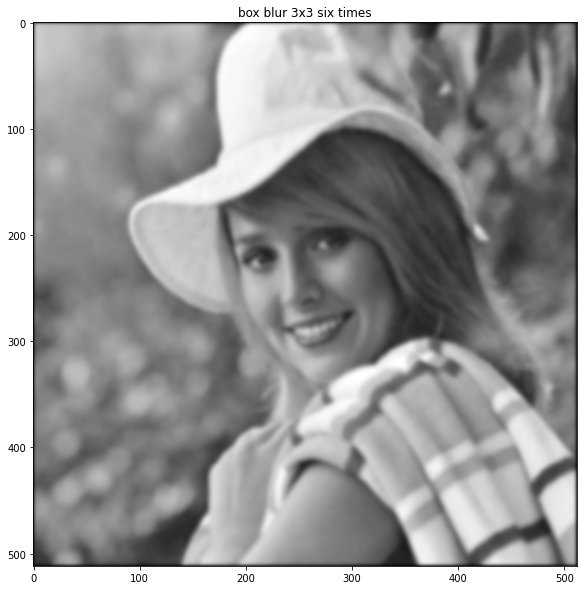

In [28]:
plt.figure(figsize=(10,10))
plt.title('box blur 3x3 six times')
plt.imshow(blur6)

###3.1.4 res

In [30]:
box_f3 = box_filter(3)
box_f5 = box_filter(5)
box_f9 = box_filter(9)
box_f15 = box_filter(15)
box_f35 = box_filter(35)

blr_box3 = convolve(box_f3,elaine)
blr_box5 = convolve(box_f5,elaine)
blr_box9 = convolve(box_f9,elaine)
blr_box15 = convolve(box_f15,elaine)
blr_box35 = convolve(box_f35,elaine)

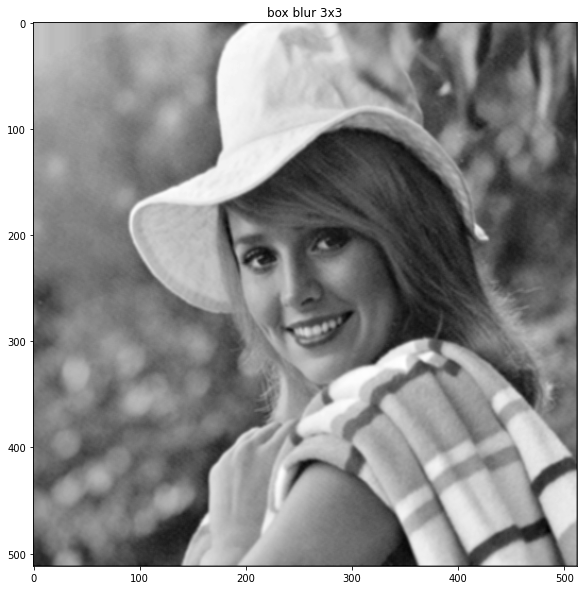

In [31]:
plt.figure(figsize=(10,10))
plt.title('box blur 3x3')
plt.imshow(blr_box3)

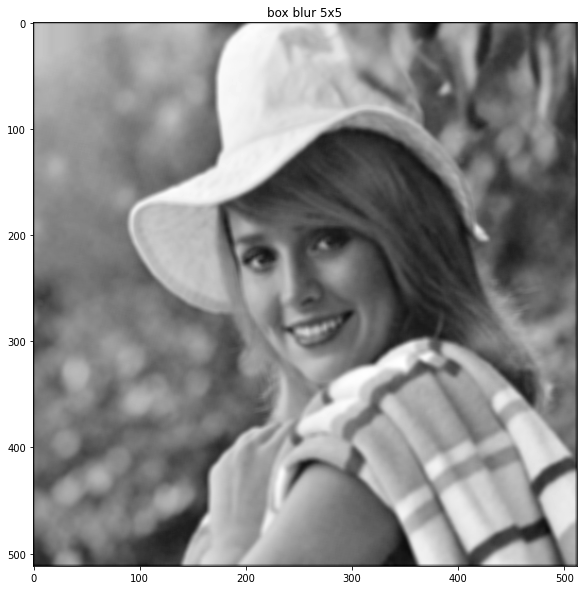

In [32]:
plt.figure(figsize=(10,10))
plt.title('box blur 5x5')
plt.imshow(blr_box5)

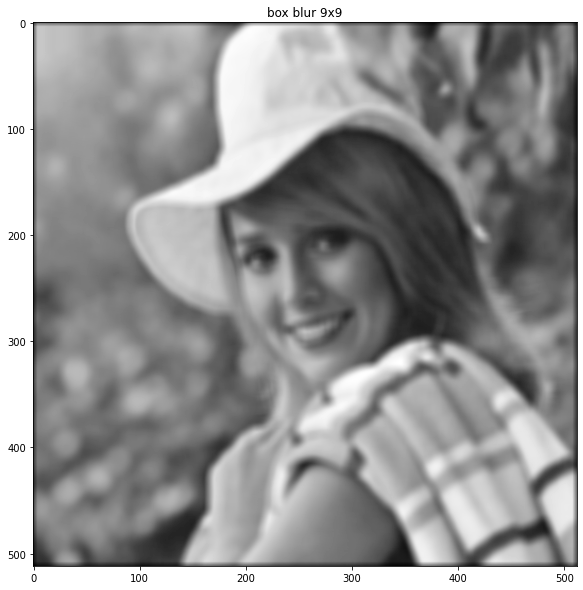

In [33]:
plt.figure(figsize=(10,10))
plt.title('box blur 9x9')
plt.imshow(blr_box9)

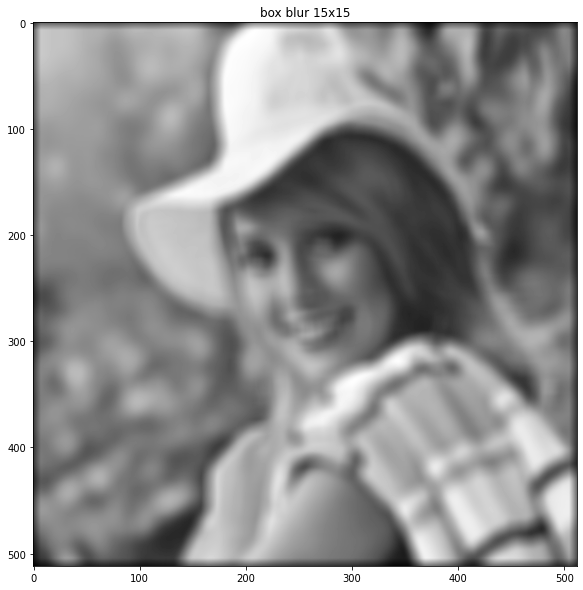

In [34]:
plt.figure(figsize=(10,10))
plt.title('box blur 15x15')
plt.imshow(blr_box15)

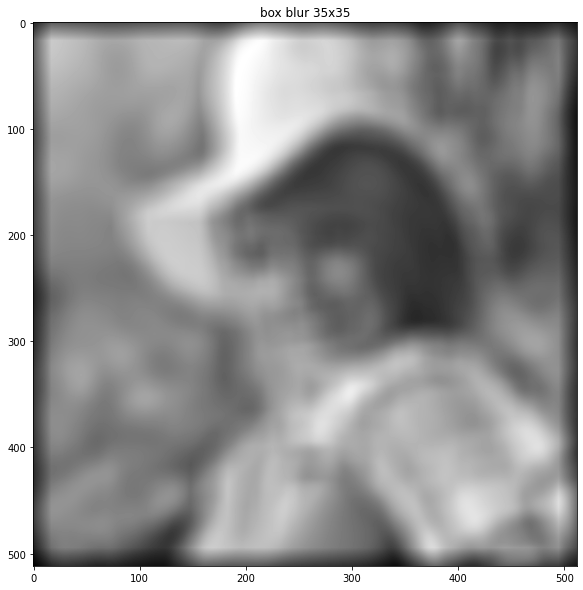

In [35]:
plt.figure(figsize=(10,10))
plt.title('box blur 35x35')
plt.imshow(blr_box35)

##3.2 Median Filter

In [71]:
def median_filter(image, filter_size):
    if filter_size%2==0:
        filter_size=filter_size+1
    elif filter_size<=2:
        filter_size=3
    temp = []
    indexer = filter_size // 2
    image_out = np.zeros((len(image),len(image[0])))
    for i in range(len(image)):
        for j in range(len(image[0])):
            for z in range(filter_size):
                if i + z - indexer < 0 or i + z - indexer > len(image) - 1:
                    for c in range(filter_size):
                        temp.append(0)
                else:
                    if j + z - indexer < 0 or j + indexer > len(image) - 1:
                        temp.append(0)
                    else:
                        for k in range(filter_size):
                            temp.append(image[i + z - indexer][j + k - indexer])
            temp.sort()
            image_out[i][j] = temp[len(temp) // 2]
            temp = []
    return image_out

###3.2.1 add salt-and-pepper noise to an image, noise density(0.05,0.1,0.2,0.4). Then, perform median filtering with a specified window size and with a square shape

In [55]:
from skimage.util import random_noise

In [64]:
sp1_noise_img = np.array(random_noise(elaine, mode='speckle',var=0.05**2)*255, dtype = 'uint8')
sp2_noise_img = np.array(random_noise(elaine, mode='speckle',var=0.1**2)*255, dtype = 'uint8')
sp3_noise_img = np.array(random_noise(elaine, mode='speckle',var=0.2**2)*255, dtype = 'uint8')
sp4_noise_img = np.array(random_noise(elaine, mode='speckle',var=0.5**2)*255, dtype = 'uint8')

####sp1

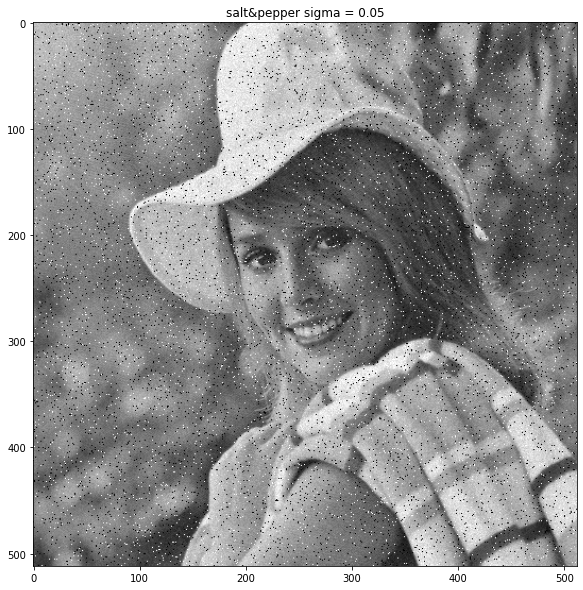

In [66]:
plt.figure(figsize=(10,10))
plt.title('salt&pepper sigma = 0.05')
plt.imshow(sp1_noise_img)

In [76]:
sp1noise_median_f3 = median_filter(sp1_noise_img,3)
sp1noise_median_f5 = median_filter(sp1_noise_img,5)
sp1noise_median_f7 = median_filter(sp1_noise_img,7)
sp1noise_median_f9 = median_filter(sp1_noise_img,9)
sp1noise_median_f11 = median_filter(sp1_noise_img,11)

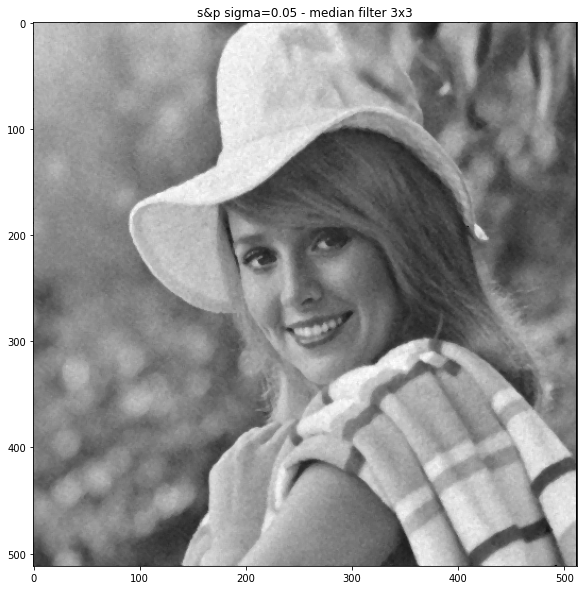

In [77]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.05 - median filter 3x3')
plt.imshow(sp1noise_median_f3)

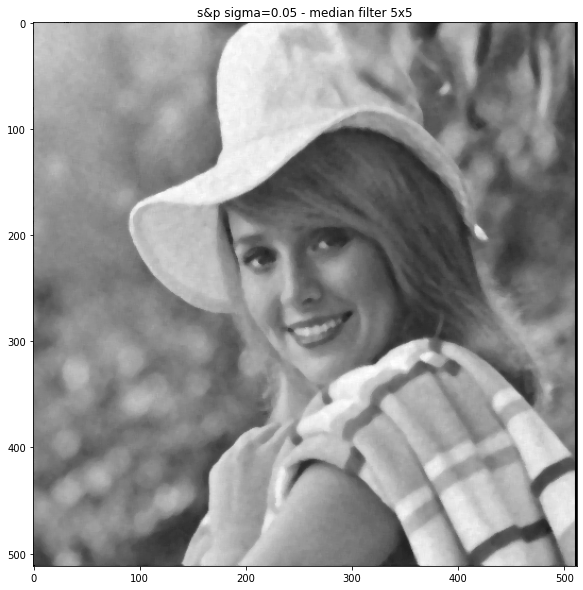

In [78]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.05 - median filter 5x5')
plt.imshow(sp1noise_median_f5)

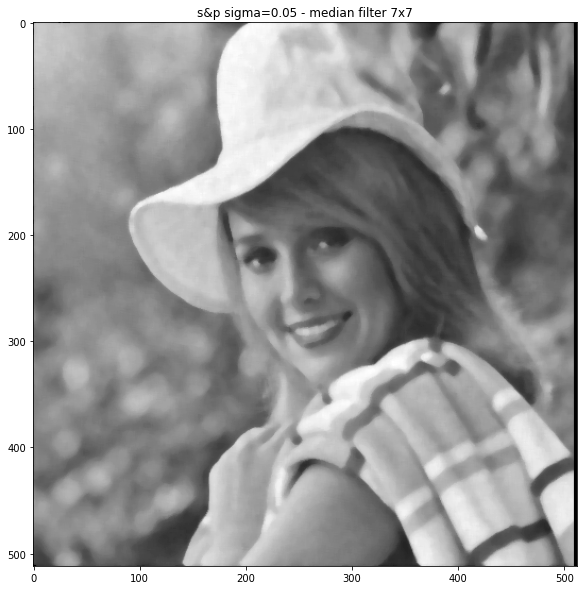

In [79]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.05 - median filter 7x7')
plt.imshow(sp1noise_median_f7)

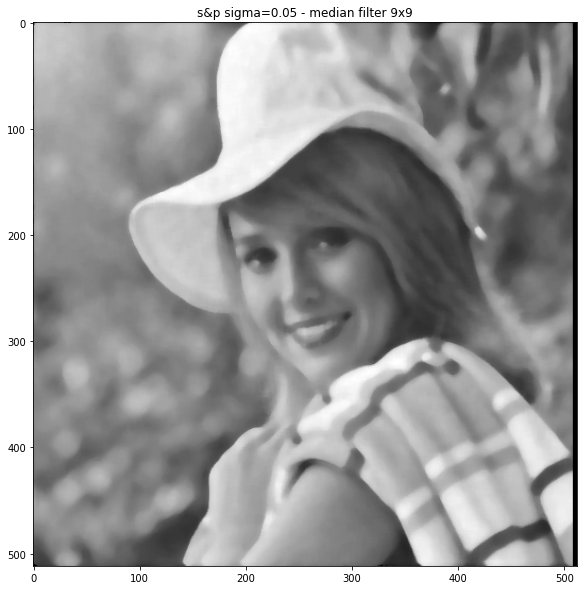

In [80]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.05 - median filter 9x9')
plt.imshow(sp1noise_median_f9)

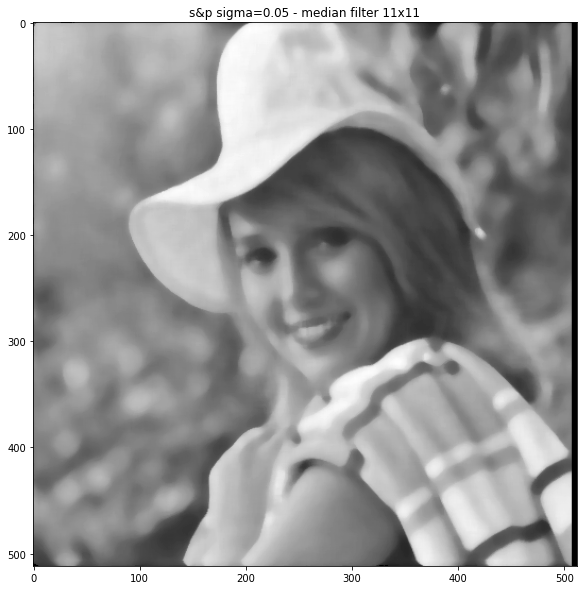

In [81]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.05 - median filter 11x11')
plt.imshow(sp1noise_median_f11)

####sp2

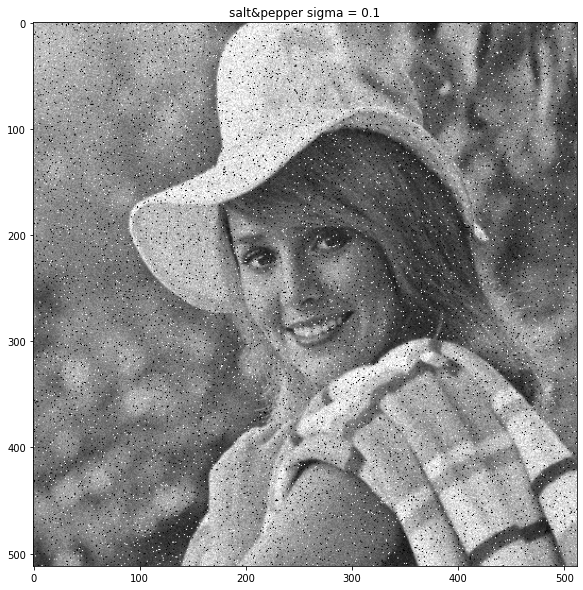

In [67]:
plt.figure(figsize=(10,10))
plt.title('salt&pepper sigma = 0.1')
plt.imshow(sp2_noise_img)

In [82]:
sp2noise_median_f3 = median_filter(sp2_noise_img,3)
sp2noise_median_f5 = median_filter(sp2_noise_img,5)
sp2noise_median_f7 = median_filter(sp2_noise_img,7)
sp2noise_median_f9 = median_filter(sp2_noise_img,9)
sp2noise_median_f11 = median_filter(sp2_noise_img,11)

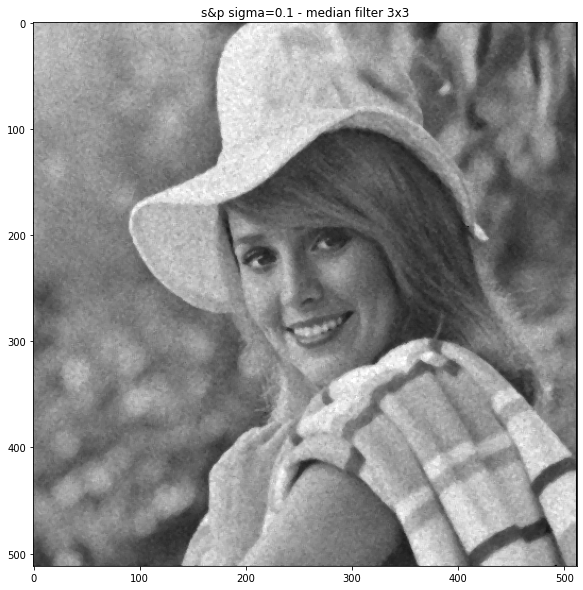

In [83]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.1 - median filter 3x3')
plt.imshow(sp2noise_median_f3)

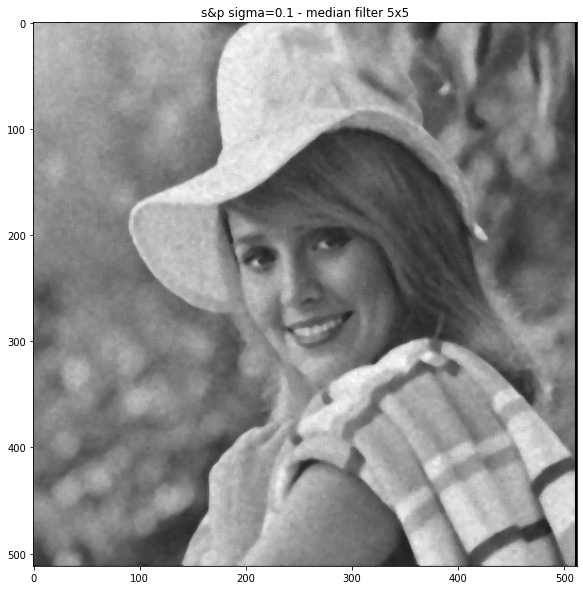

In [84]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.1 - median filter 5x5')
plt.imshow(sp2noise_median_f5)

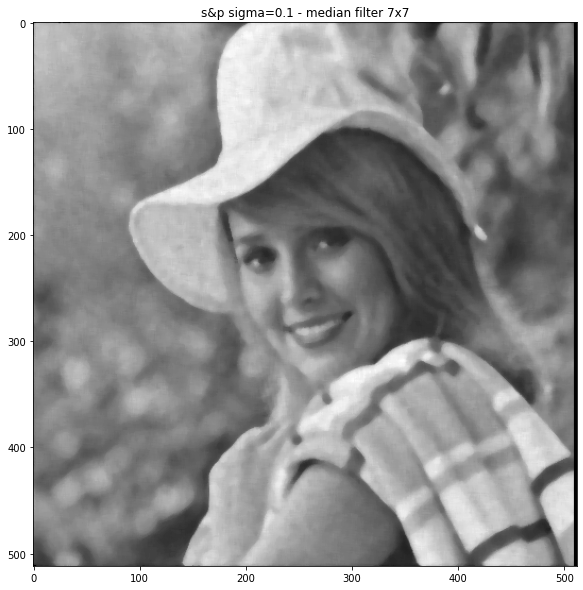

In [85]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.1 - median filter 7x7')
plt.imshow(sp2noise_median_f7)

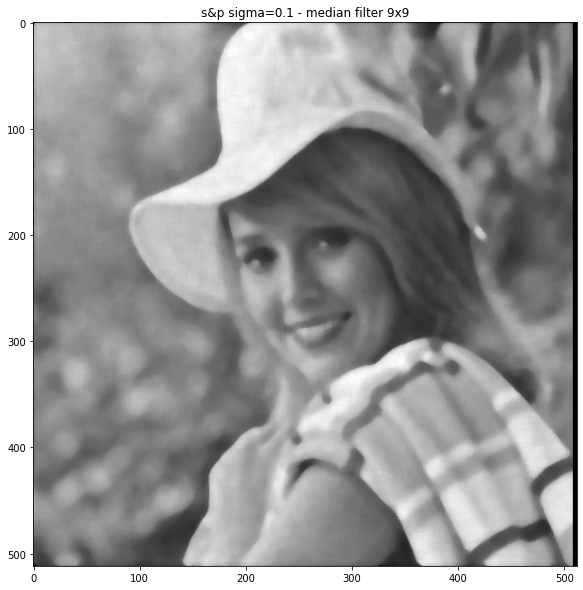

In [86]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.1 - median filter 9x9')
plt.imshow(sp2noise_median_f9)

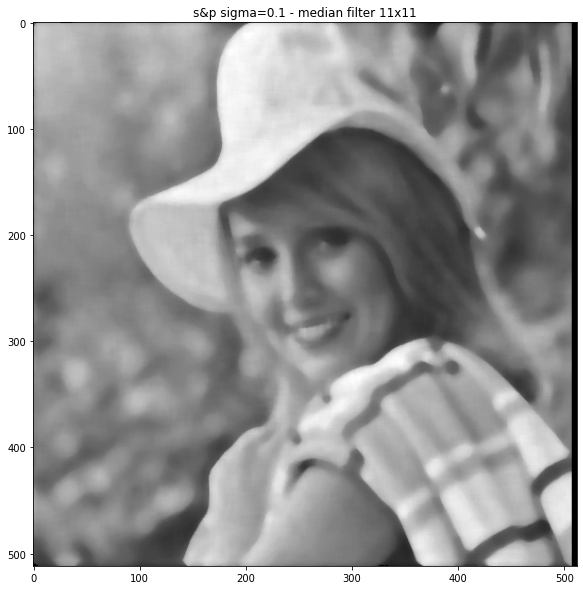

In [87]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.1 - median filter 11x11')
plt.imshow(sp2noise_median_f11)

####sp3

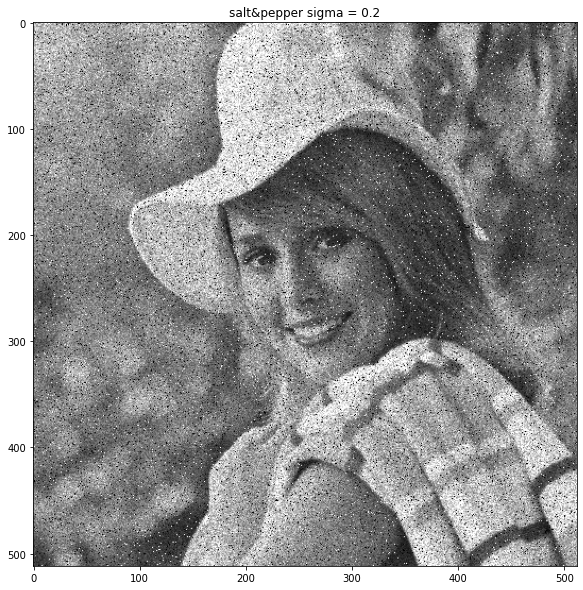

In [68]:
plt.figure(figsize=(10,10))
plt.title('salt&pepper sigma = 0.2')
plt.imshow(sp3_noise_img)

In [88]:
sp3noise_median_f3 = median_filter(sp3_noise_img,3)
sp3noise_median_f5 = median_filter(sp3_noise_img,5)
sp3noise_median_f7 = median_filter(sp3_noise_img,7)
sp3noise_median_f9 = median_filter(sp3_noise_img,9)
sp3noise_median_f11 = median_filter(sp3_noise_img,11)

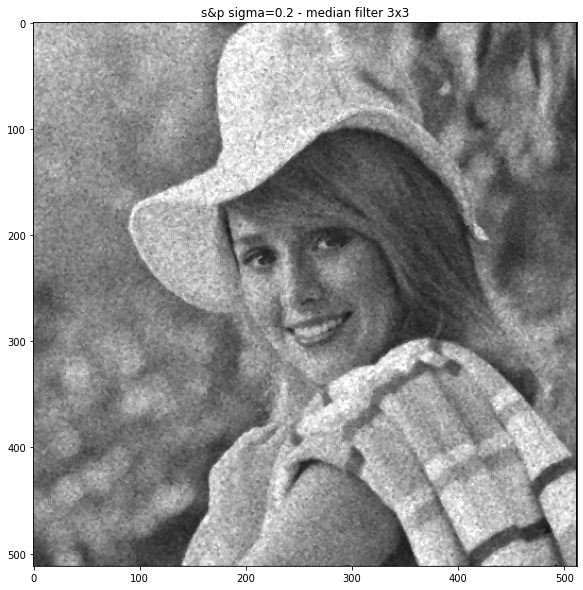

In [89]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.2 - median filter 3x3')
plt.imshow(sp3noise_median_f3)

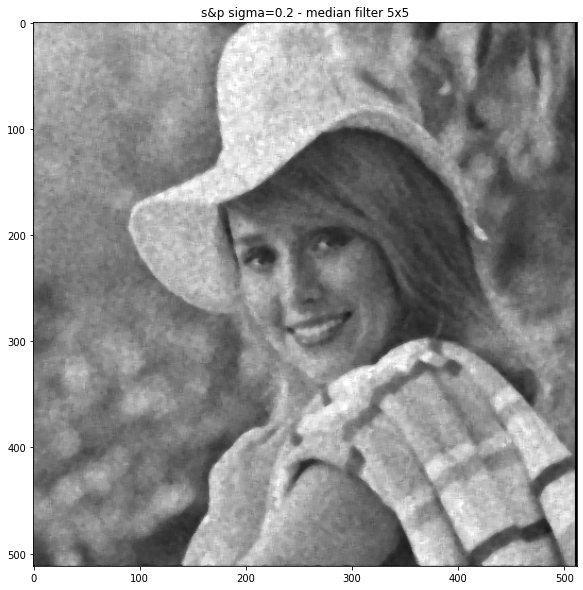

In [90]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.2 - median filter 5x5')
plt.imshow(sp3noise_median_f5)

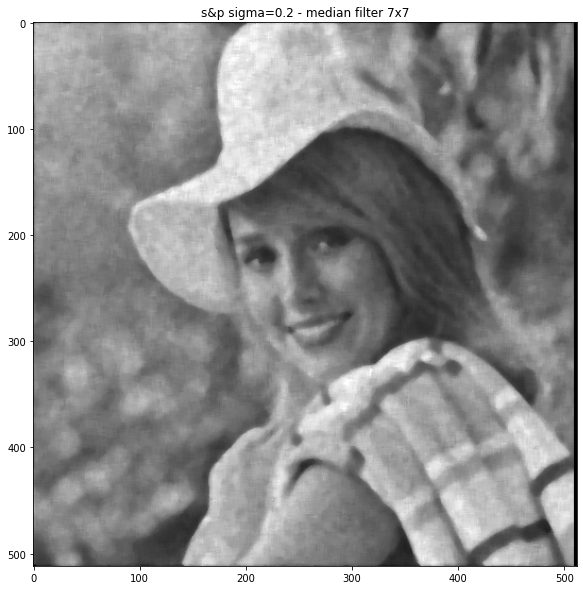

In [91]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.2 - median filter 7x7')
plt.imshow(sp3noise_median_f7)

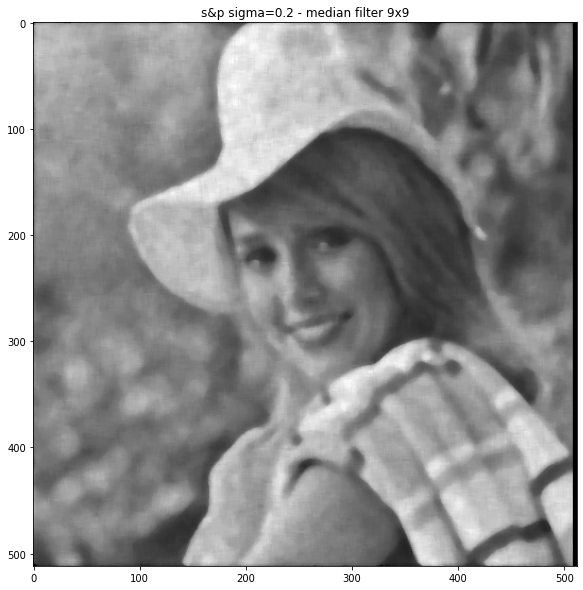

In [92]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.2 - median filter 9x9')
plt.imshow(sp3noise_median_f9)

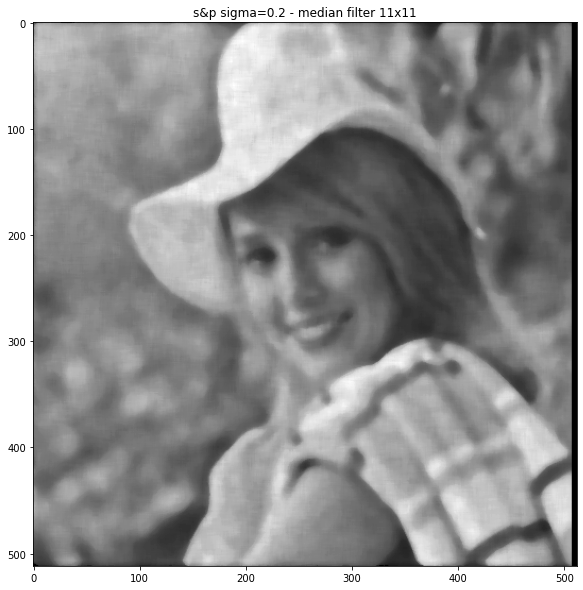

In [93]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.2 - median filter 11x11')
plt.imshow(sp3noise_median_f11)

####sp4

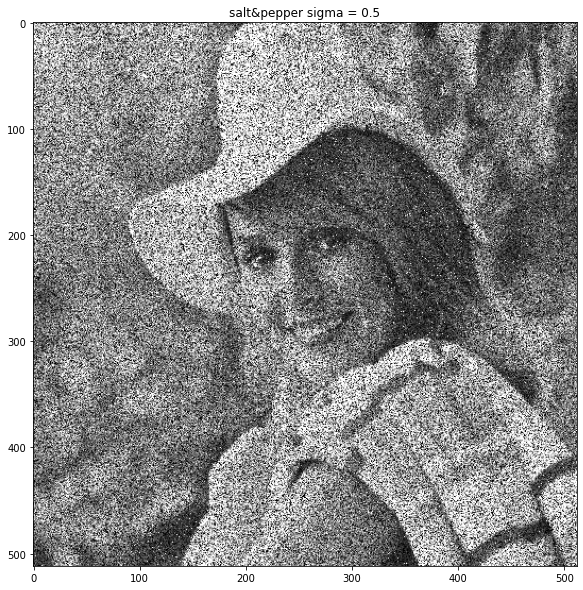

In [69]:
plt.figure(figsize=(10,10))
plt.title('salt&pepper sigma = 0.5')
plt.imshow(sp4_noise_img)

In [94]:
sp4noise_median_f3 = median_filter(sp4_noise_img,3)
sp4noise_median_f5 = median_filter(sp4_noise_img,5)
sp4noise_median_f7 = median_filter(sp4_noise_img,7)
sp4noise_median_f9 = median_filter(sp4_noise_img,9)
sp4noise_median_f11 = median_filter(sp4_noise_img,11)

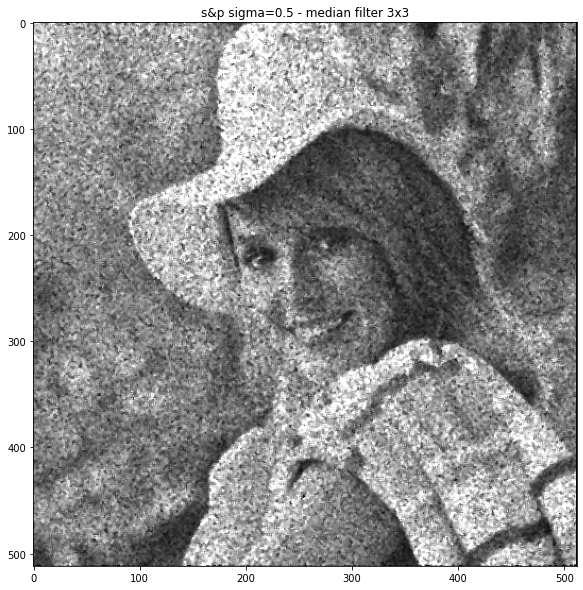

In [95]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.5 - median filter 3x3')
plt.imshow(sp4noise_median_f3)

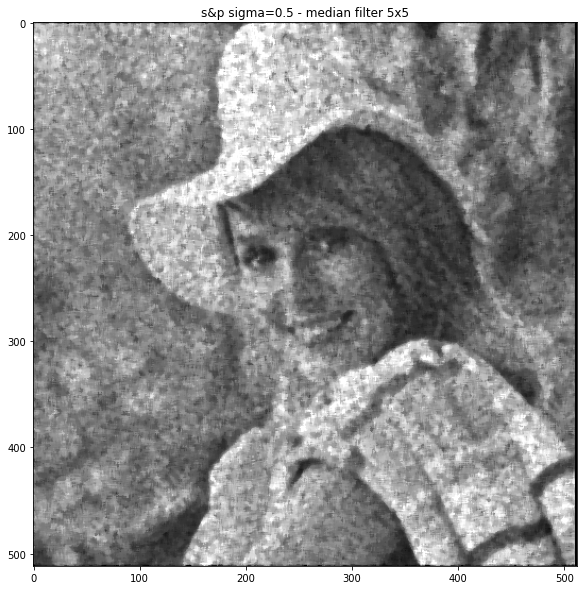

In [96]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.5 - median filter 5x5')
plt.imshow(sp4noise_median_f5)

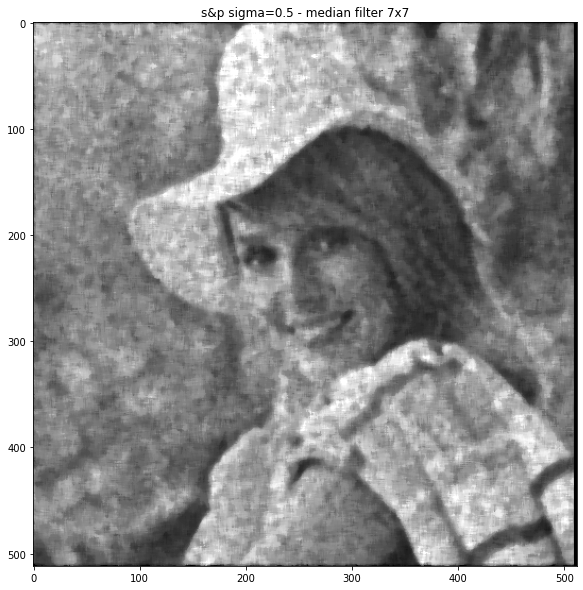

In [97]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.5 - median filter 7x7')
plt.imshow(sp4noise_median_f7)

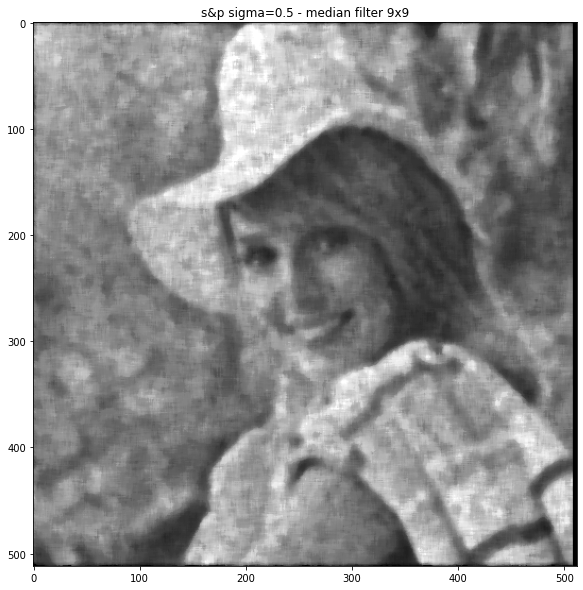

In [98]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.5 - median filter 9x9')
plt.imshow(sp4noise_median_f9)

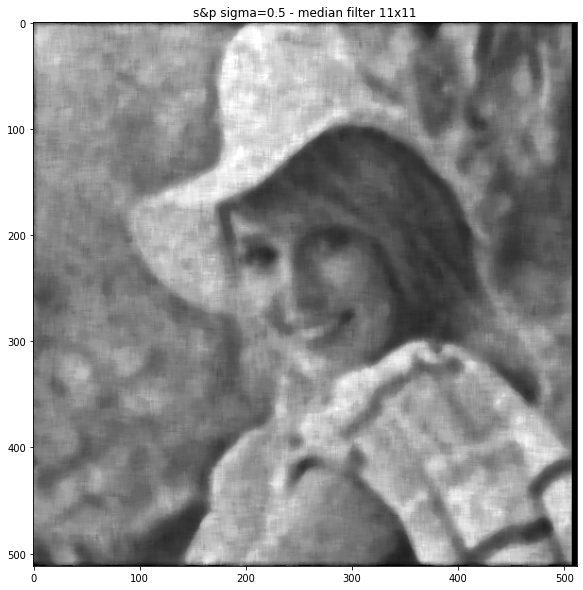

In [99]:
plt.figure(figsize=(10,10))
plt.title('s&p sigma=0.5 - median filter 11x11')
plt.imshow(sp4noise_median_f11)

####mse

In [100]:
def MSE(x,y):
  return np.square(np.subtract(x,y)).mean()

In [102]:
df = pd.DataFrame(
    [
    ('sigma = 0.05', MSE(elaine, sp1noise_median_f3), MSE(elaine, sp1noise_median_f5),
                    MSE(elaine, sp1noise_median_f7), MSE(elaine, sp1noise_median_f9), MSE(elaine, sp1noise_median_f11)
    ),
    ('sigma = 0.1', MSE(elaine, sp2noise_median_f3), MSE(elaine, sp2noise_median_f5),
                    MSE(elaine, sp2noise_median_f7), MSE(elaine, sp2noise_median_f9), MSE(elaine, sp2noise_median_f11)
    ),
    ('sigma = 0.2', MSE(elaine, sp3noise_median_f3), MSE(elaine, sp3noise_median_f5),
                    MSE(elaine, sp3noise_median_f7), MSE(elaine, sp3noise_median_f9), MSE(elaine, sp3noise_median_f11)
    ),
    ('sigma = 0.5', MSE(elaine, sp4noise_median_f3), MSE(elaine, sp4noise_median_f5),
                    MSE(elaine, sp4noise_median_f7), MSE(elaine, sp4noise_median_f9), MSE(elaine, sp4noise_median_f11)
     )
    ],
    columns=('', '3x3', '5x5', '7x7', '9x9', '11x11')
)

In [104]:
df

,,3x3,5x5,7x7,9x9,11x11
0,sigma = 0.05,813.885532,859.839096,899.951393,942.794144,988.814659
1,sigma = 0.1,833.660961,869.571842,907.882851,951.238842,998.175468
2,sigma = 0.2,926.647282,911.296482,938.130463,979.433563,1027.514576
3,sigma = 0.5,1585.927929,1196.418518,1126.808235,1142.120033,1184.815178


###3.2.2 gaussian


In [105]:
g1_noise_img = np.array(random_noise(elaine, mode='gaussian',var=0.01**2)*255, dtype = 'uint8')
g2_noise_img = np.array(random_noise(elaine, mode='gaussian',var=0.05**2)*255, dtype = 'uint8')
g3_noise_img = np.array(random_noise(elaine, mode='gaussian',var=0.1**2)*255, dtype = 'uint8')

####g1 = 0.01

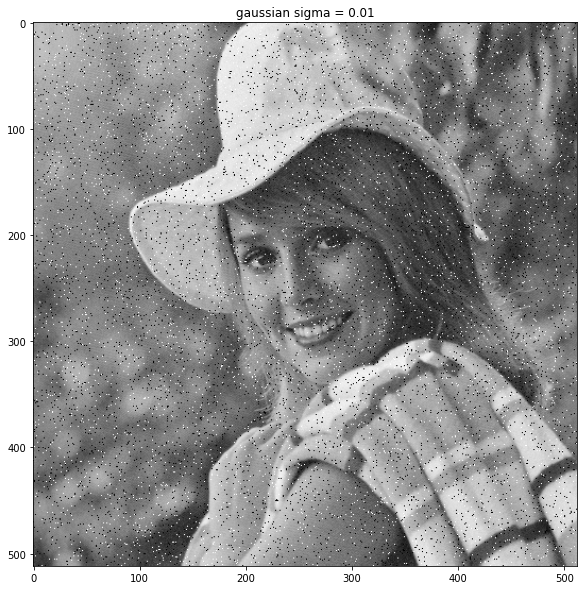

In [107]:
plt.figure(figsize=(10,10))
plt.title('gaussian sigma = 0.01')
plt.imshow(g1_noise_img)

In [108]:
g1noise_median_f3 = median_filter(g1_noise_img,3)
g1noise_median_f5 = median_filter(g1_noise_img,5)
g1noise_median_f7 = median_filter(g1_noise_img,7)
g1noise_median_f9 = median_filter(g1_noise_img,9)
g1noise_median_f11 = median_filter(g1_noise_img,11)

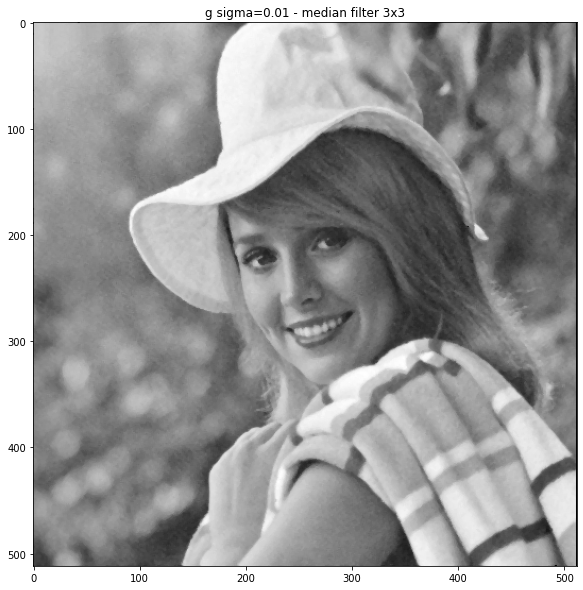

In [109]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.01 - median filter 3x3')
plt.imshow(g1noise_median_f3)

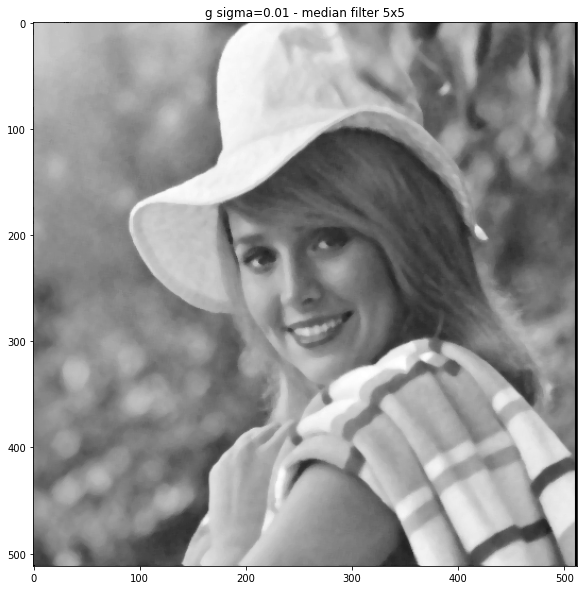

In [110]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.01 - median filter 5x5')
plt.imshow(g1noise_median_f5)

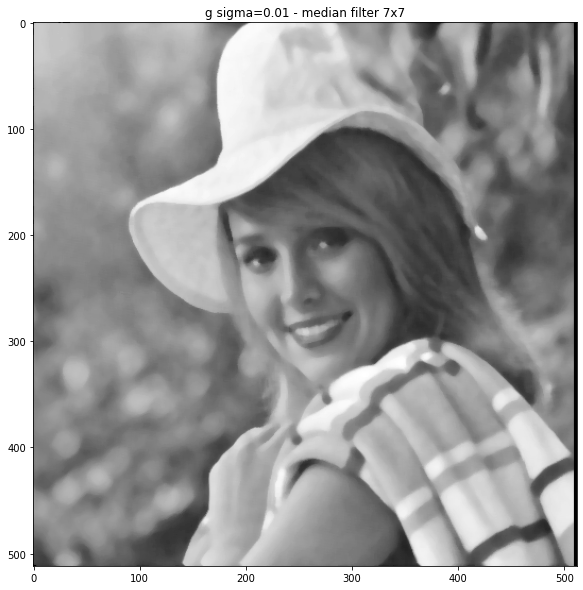

In [111]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.01 - median filter 7x7')
plt.imshow(g1noise_median_f7)

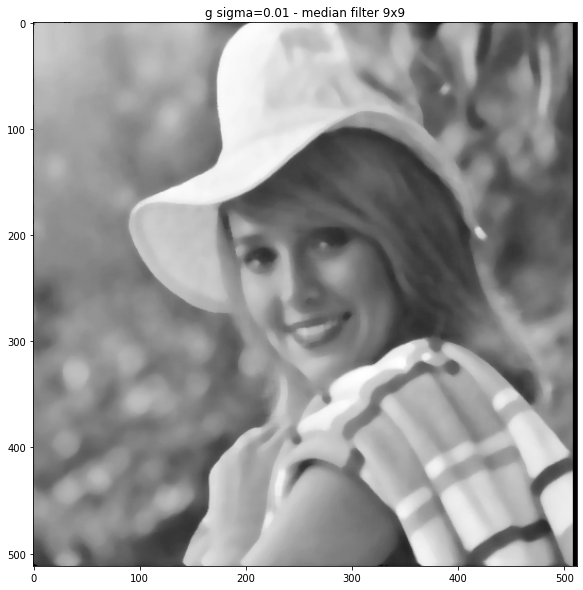

In [112]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.01 - median filter 9x9')
plt.imshow(g1noise_median_f9)

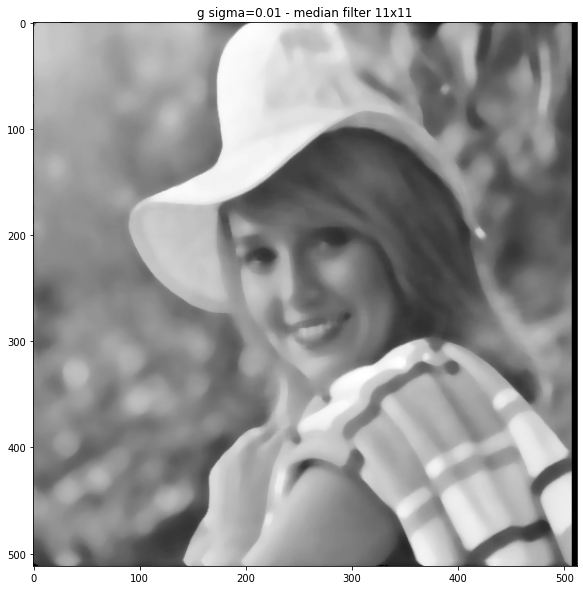

In [113]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.01 - median filter 11x11')
plt.imshow(g1noise_median_f11)

####g1 box

In [130]:
box_f3 = box_filter(3)
box_f5 = box_filter(5)
box_f7 = box_filter(7)
box_f9 = box_filter(9)
box_f11 = box_filter(11)

In [131]:
g1_f3 = convolve(box_f3,g1_noise_img)
g1_f5 = convolve(box_f5,g1_noise_img)
g1_f7 = convolve(box_f7,g1_noise_img)
g1_f9 = convolve(box_f9,g1_noise_img)
g1_f11 = convolve(box_f11,g1_noise_img)

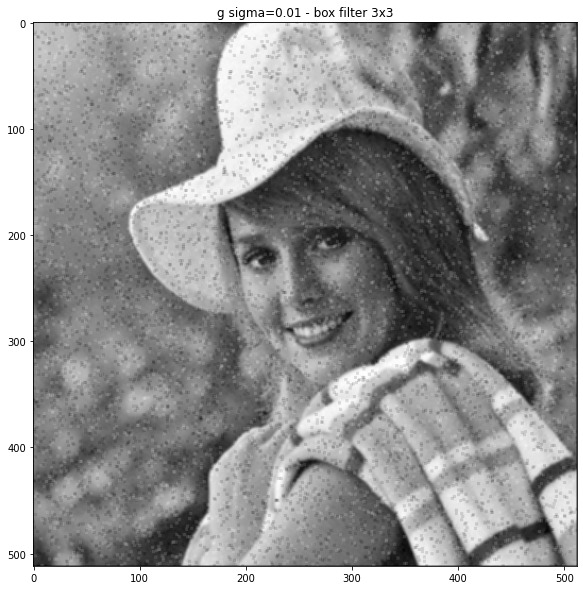

In [132]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.01 - box filter 3x3')
plt.imshow(g1_f3)

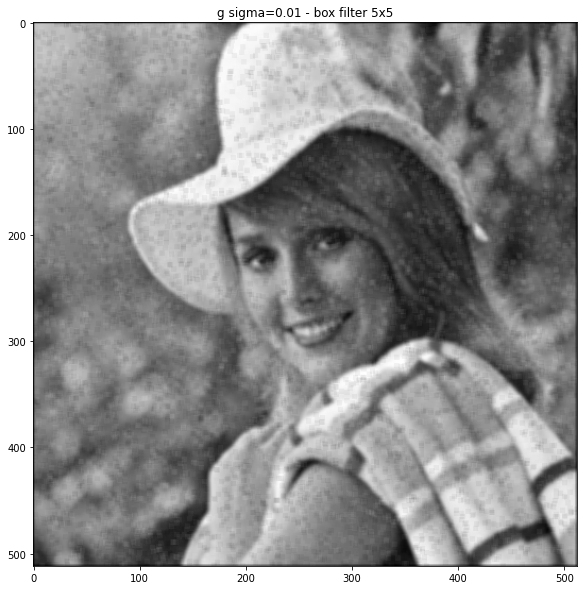

In [133]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.01 - box filter 5x5')
plt.imshow(g1_f5)

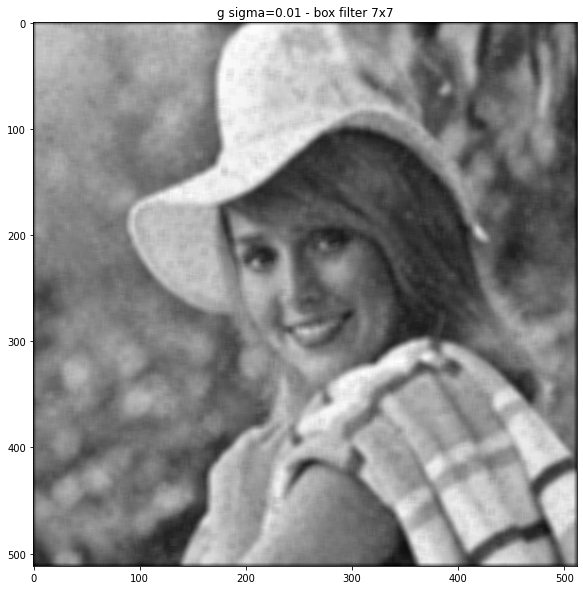

In [134]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.01 - box filter 7x7')
plt.imshow(g1_f7)

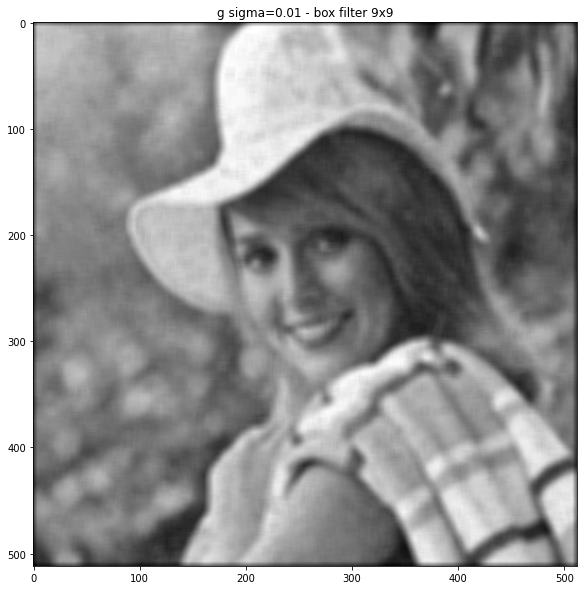

In [135]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.01 - box filter 9x9')
plt.imshow(g1_f9)

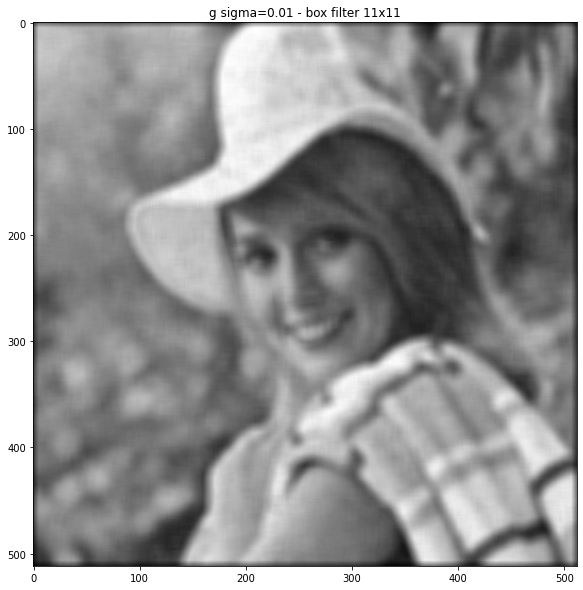

In [136]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.01 - box filter 11x11')
plt.imshow(g1_f11)

####g2 = 0.05

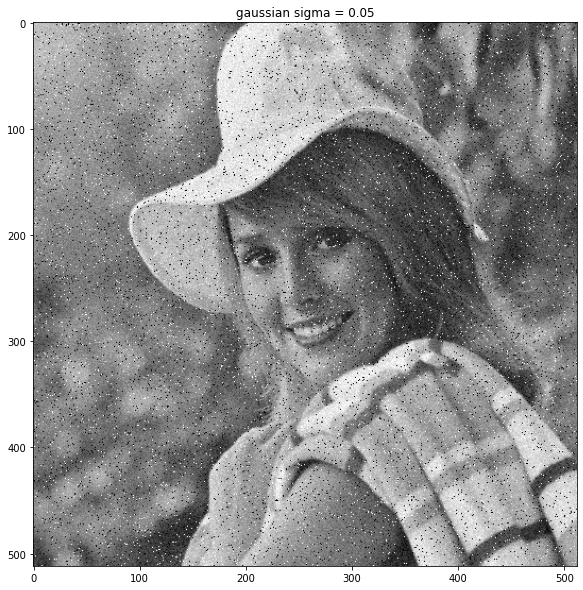

In [114]:
plt.figure(figsize=(10,10))
plt.title('gaussian sigma = 0.05')
plt.imshow(g2_noise_img)

In [115]:
g2noise_median_f3 = median_filter(g2_noise_img,3)
g2noise_median_f5 = median_filter(g2_noise_img,5)
g2noise_median_f7 = median_filter(g2_noise_img,7)
g2noise_median_f9 = median_filter(g2_noise_img,9)
g2noise_median_f11 = median_filter(g2_noise_img,11)

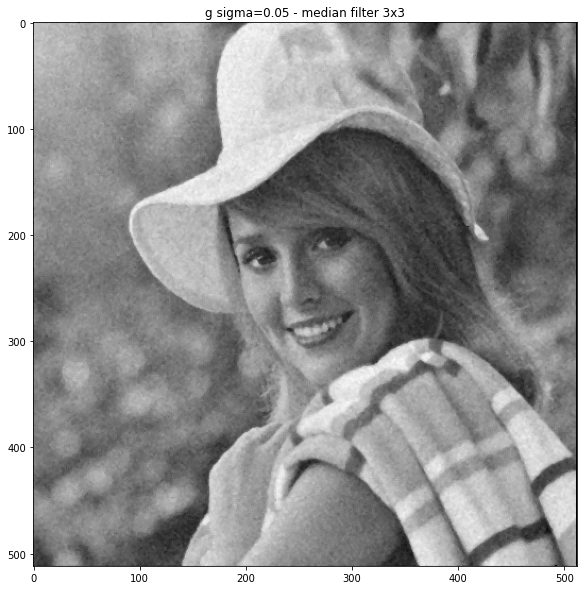

In [116]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.05 - median filter 3x3')
plt.imshow(g2noise_median_f3)

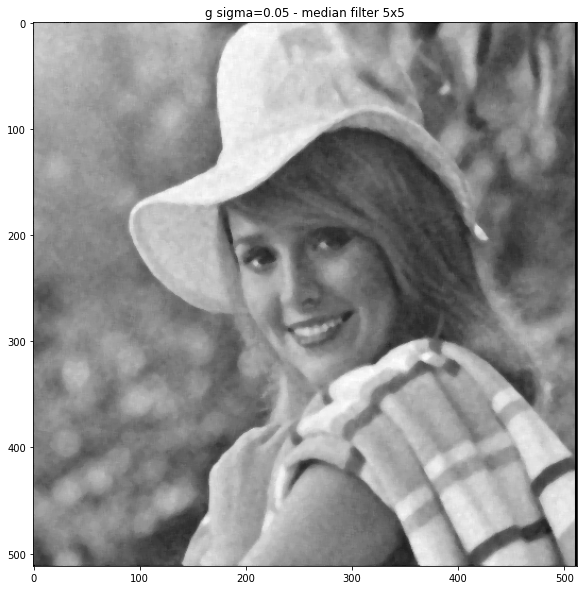

In [117]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.05 - median filter 5x5')
plt.imshow(g2noise_median_f5)

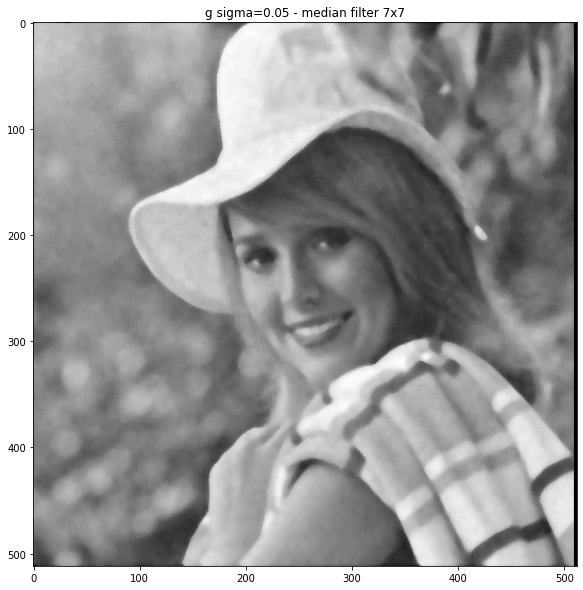

In [118]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.05 - median filter 7x7')
plt.imshow(g2noise_median_f7)

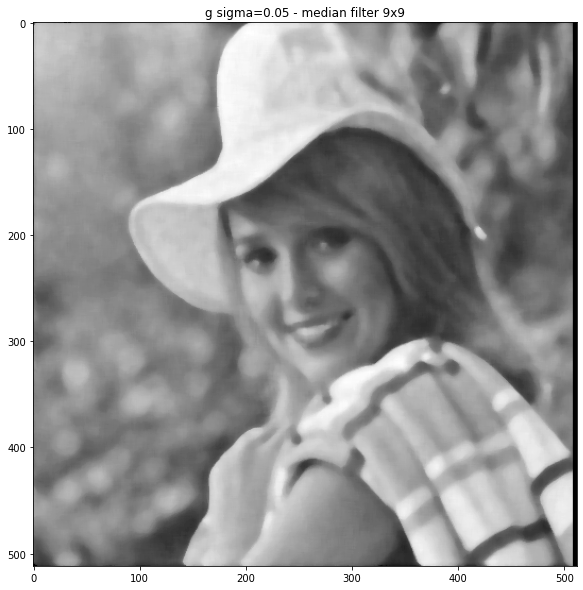

In [119]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.05 - median filter 9x9')
plt.imshow(g2noise_median_f9)

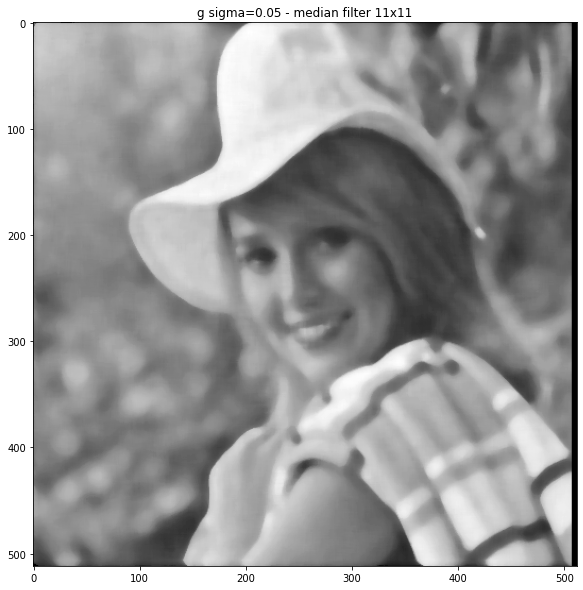

In [120]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.05 - median filter 11x11')
plt.imshow(g2noise_median_f11)

####g2 box

In [137]:
g2_f3 = convolve(box_f3,g2_noise_img)
g2_f5 = convolve(box_f5,g2_noise_img)
g2_f7 = convolve(box_f7,g2_noise_img)
g2_f9 = convolve(box_f9,g2_noise_img)
g2_f11 = convolve(box_f11,g2_noise_img)

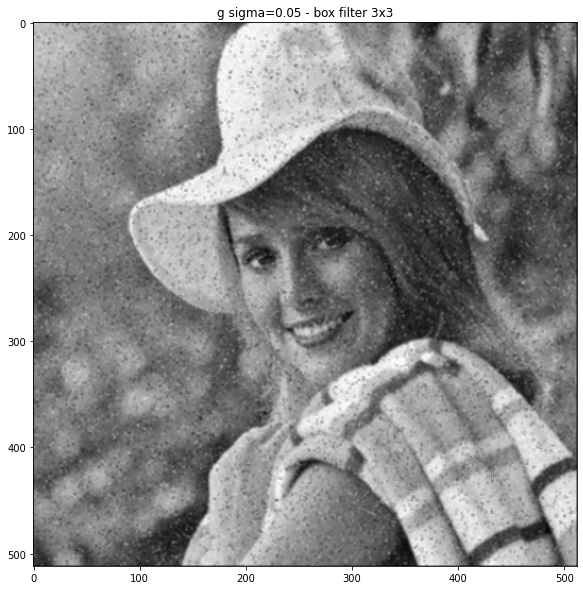

In [138]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.05 - box filter 3x3')
plt.imshow(g2_f3)

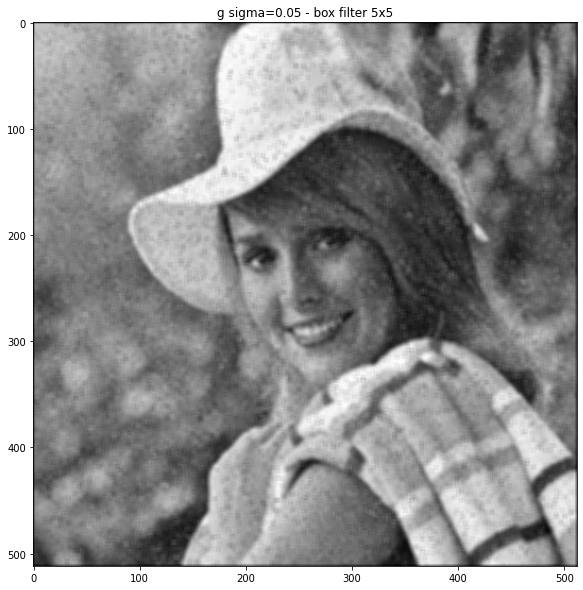

In [139]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.05 - box filter 5x5')
plt.imshow(g2_f5)

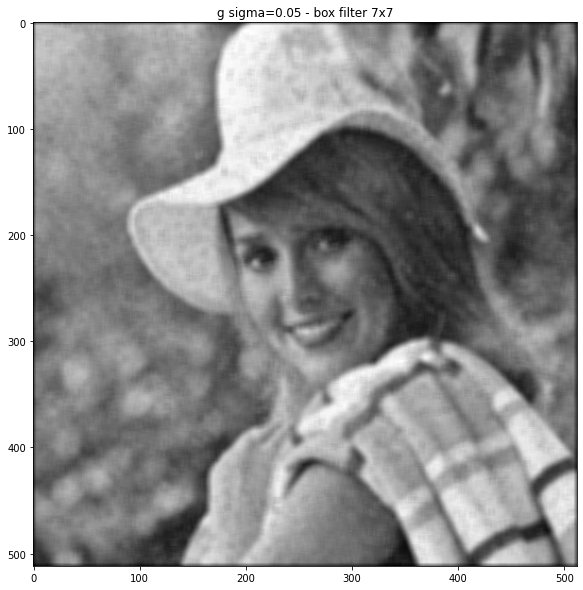

In [140]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.05 - box filter 7x7')
plt.imshow(g2_f7)

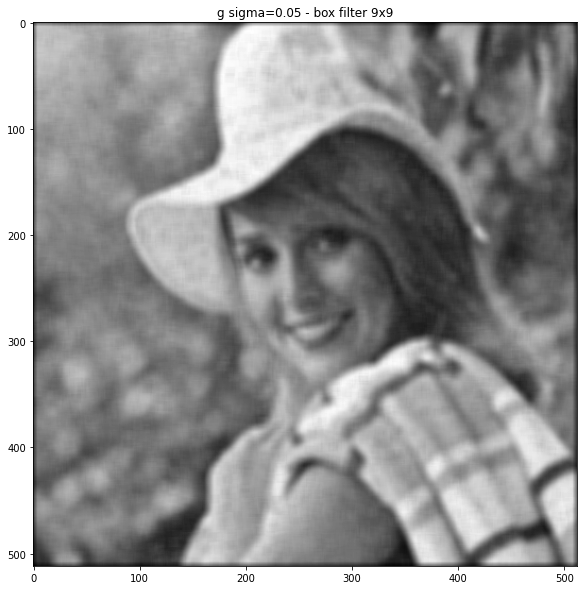

In [141]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.05 - box filter 9x9')
plt.imshow(g2_f9)

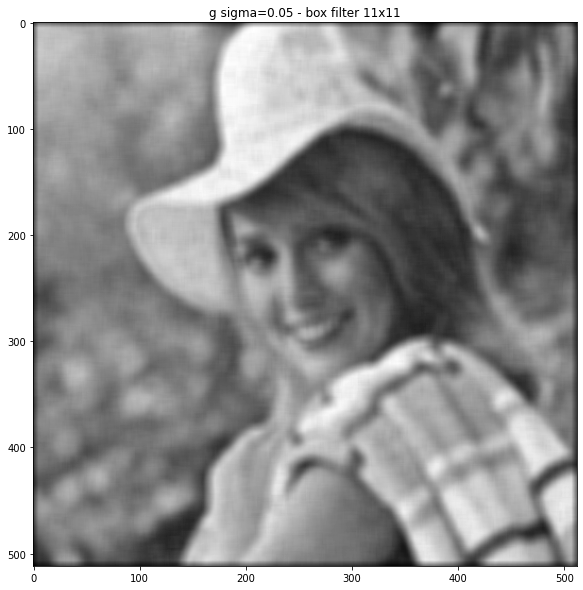

In [142]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.05 - box filter 11x11')
plt.imshow(g2_f11)

####g3 box

In [143]:
g3_f3 = convolve(box_f3,g3_noise_img)
g3_f5 = convolve(box_f5,g3_noise_img)
g3_f7 = convolve(box_f7,g3_noise_img)
g3_f9 = convolve(box_f9,g3_noise_img)
g3_f11 = convolve(box_f11,g3_noise_img)

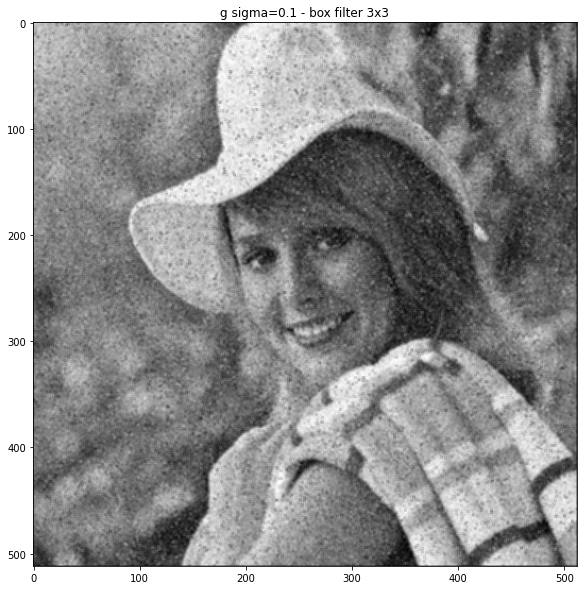

In [145]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.1 - box filter 3x3')
plt.imshow(g3_f3)

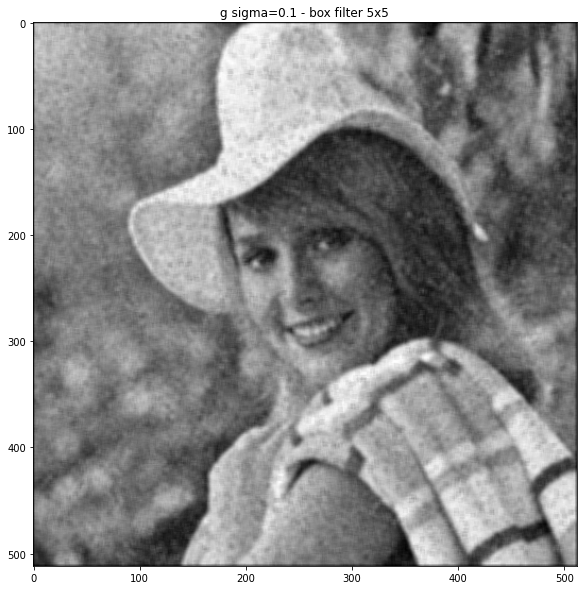

In [146]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.1 - box filter 5x5')
plt.imshow(g3_f5)

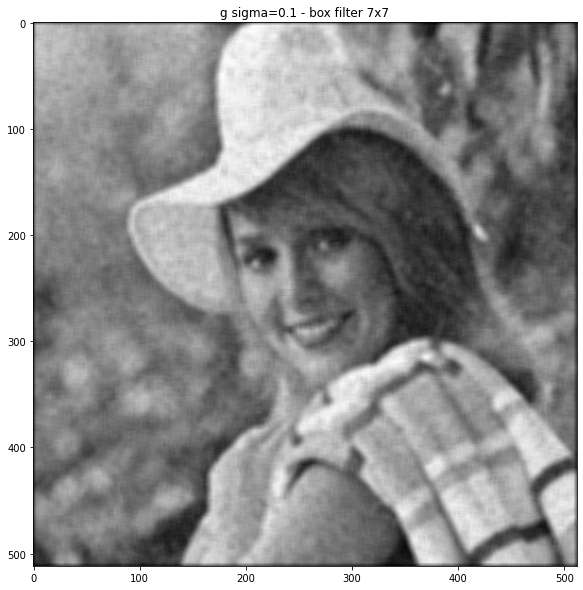

In [147]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.1 - box filter 7x7')
plt.imshow(g3_f7)

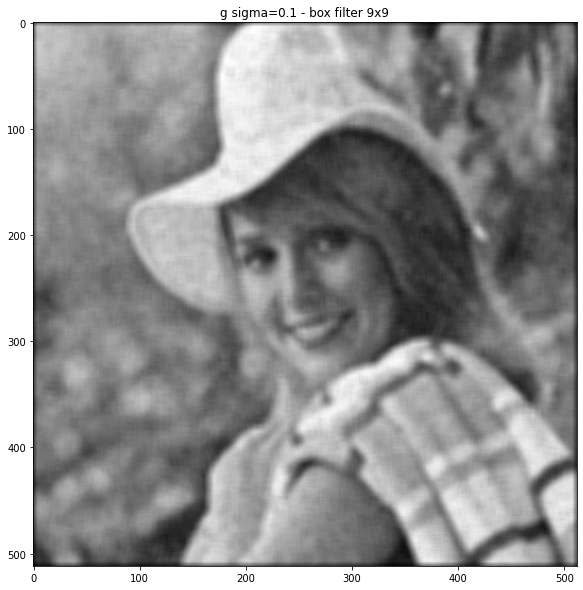

In [148]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.1 - box filter 9x9')
plt.imshow(g3_f9)

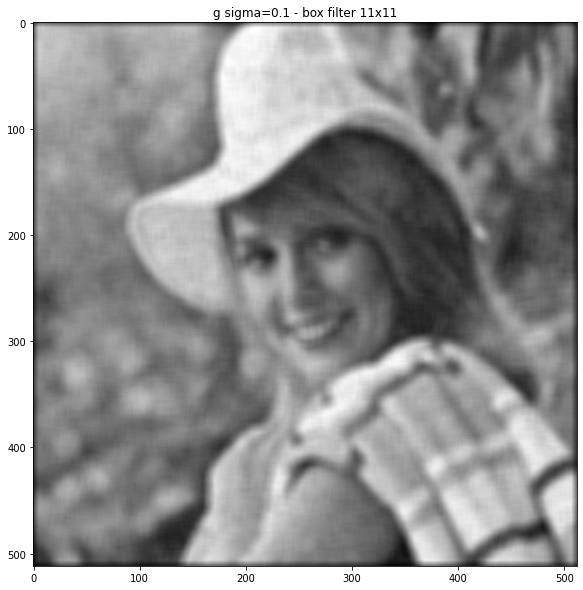

In [149]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.1 - box filter 11x11')
plt.imshow(g3_f11)

####g3 = 0.1

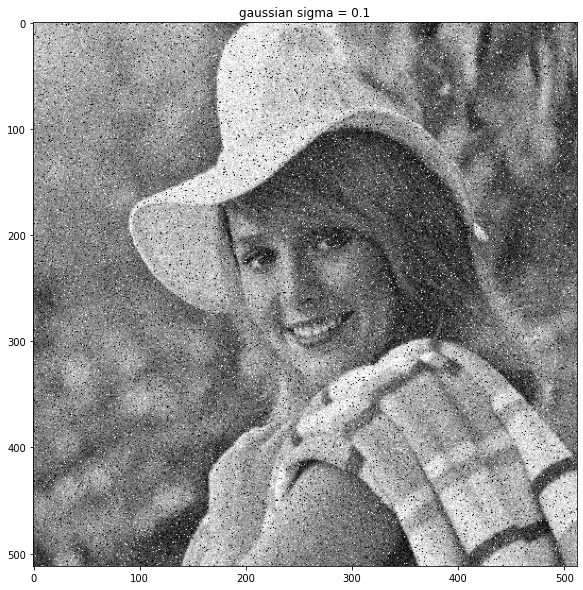

In [121]:
plt.figure(figsize=(10,10))
plt.title('gaussian sigma = 0.1')
plt.imshow(g3_noise_img)

In [122]:
g3noise_median_f3 = median_filter(g3_noise_img,3)
g3noise_median_f5 = median_filter(g3_noise_img,5)
g3noise_median_f7 = median_filter(g3_noise_img,7)
g3noise_median_f9 = median_filter(g3_noise_img,9)
g3noise_median_f11 = median_filter(g3_noise_img,11)

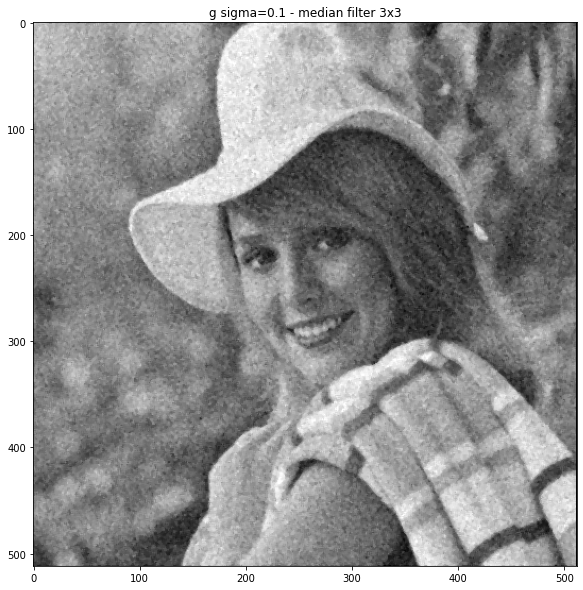

In [123]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.1 - median filter 3x3')
plt.imshow(g3noise_median_f3)

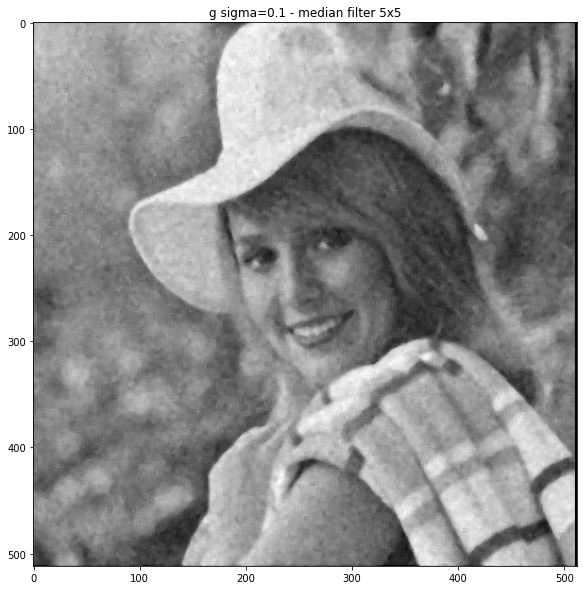

In [124]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.1 - median filter 5x5')
plt.imshow(g3noise_median_f5)

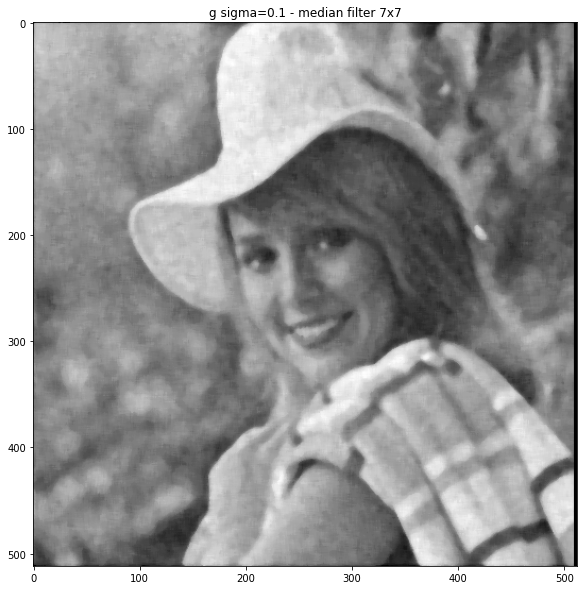

In [125]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.1 - median filter 7x7')
plt.imshow(g3noise_median_f7)

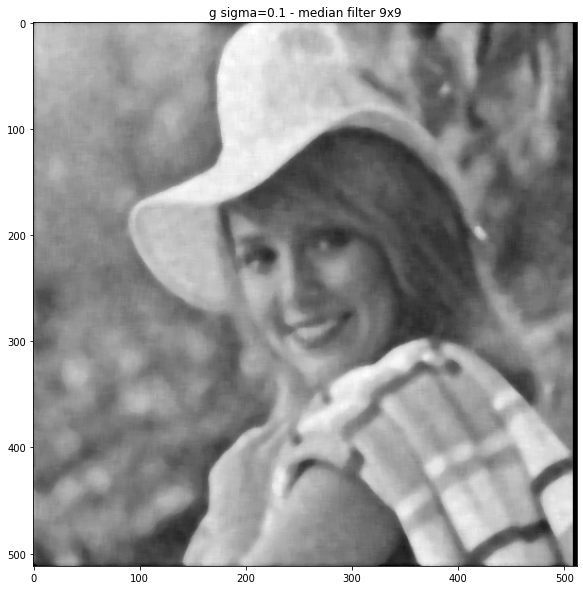

In [126]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.1 - median filter 9x9')
plt.imshow(g3noise_median_f9)

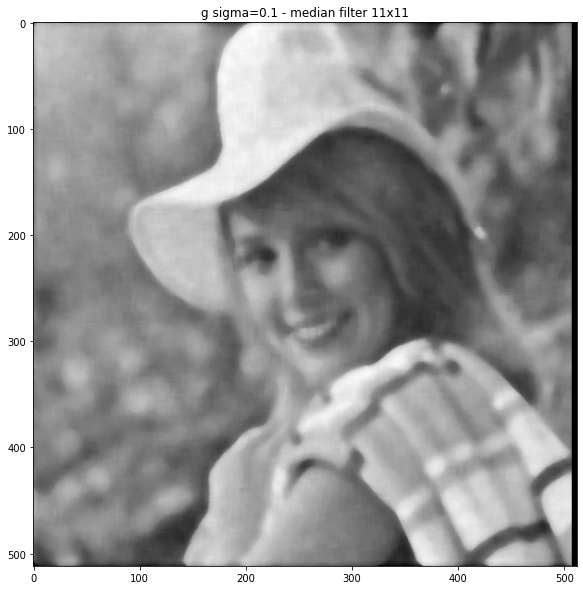

In [127]:
plt.figure(figsize=(10,10))
plt.title('g sigma=0.1 - median filter 11x11')
plt.imshow(g3noise_median_f11)

In [150]:
df2 = pd.DataFrame(
    [
    ('sigma = 0.01', MSE(elaine, g1noise_median_f3), MSE(elaine, g1noise_median_f5),
                    MSE(elaine, g1noise_median_f7), MSE(elaine, g1noise_median_f9), MSE(elaine, g1noise_median_f11),
     
                    MSE(elaine, g1_f3), MSE(elaine, g1_f5),
                    MSE(elaine, g1_f7), MSE(elaine, g1_f9), MSE(elaine, g1_f11)
    ),
    ('sigma = 0.05', MSE(elaine, g2noise_median_f3), MSE(elaine, g2noise_median_f5),
                    MSE(elaine, g2noise_median_f7), MSE(elaine, g2noise_median_f9), MSE(elaine, g2noise_median_f11),
     
                    MSE(elaine, g2_f3), MSE(elaine, g2_f5),
                    MSE(elaine, g2_f7), MSE(elaine, g2_f9), MSE(elaine, g2_f11)
    ),
    ('sigma = 0.1', MSE(elaine, g3noise_median_f3), MSE(elaine, g3noise_median_f5),
                    MSE(elaine, g3noise_median_f7), MSE(elaine, g3noise_median_f9), MSE(elaine, g3noise_median_f11),
     
                    MSE(elaine, g3_f3), MSE(elaine, g3_f5),
                    MSE(elaine, g3_f7), MSE(elaine, g3_f9), MSE(elaine, g3_f11)
    )
    ],
    columns=('', 'median 3x3', '5x5', '7x7', '9x9', '11x11','box filter 3x3', '5x5', '7x7', '9x9', '11x11')
)

In [151]:
df2

,,median 3x3,5x5,7x7,9x9,11x11,box filter 3x3,5x5,7x7,9x9,11x11
0,sigma = 0.01,808.815765,857.211170,897.753304,940.648396,986.157822,719.795312,806.985701,853.229552,897.595064,940.669869
1,sigma = 0.05,828.186096,867.266632,905.788376,948.392120,994.486061,736.688424,812.944977,856.576521,899.722275,941.972591
2,sigma = 0.1,899.124931,897.718830,926.888783,968.066349,1016.020550,789.275920,832.219443,866.473100,906.161241,947.027046


##3.3. Sharpening, Blurring, and Noise Removal

##3.4. Edge Detection

##3.5. Unsharp Masking